In [2]:
%load_ext autoreload
%autoreload 2

import cv2
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import glob
import h5py

import sys
sys.path.append('../../src')
from utils import smooth_curve
from Viz import show_images
from PlumeDataset import plume_dataset
from AutoAlign import align_plumes
from Velocity import VelocityCalculator
from PlumeMetrics import PlumeMetrics

def analyze_function(P, V, plumes, threshold, index, viz_index, plume_name, 
                     align_parms={'align':False, 'coords':None, 'coords_standard':None}):
    # plumes = plumes[x_range[0]:x_range[1]]

    # align plumes
    if align_parms['align']:
        if align_parms['coords'] is None or align_parms['coords_standard'] is None:
            raise ValueError('Please provide the coordinates for alignment')
        else:
            plumes = align_plumes(plumes, align_parms['coords'], align_parms['coords_standard'])

    show_images(plumes[index][viz_index], img_per_row=16, img_height=1, title=plume_name)
    plt.show()

    areas, coords, labeled_images = P.calculate_area_for_plumes(plumes, threshold=threshold, return_format='dataframe')
    df_area = P.to_df(areas)

    print(plumes[index][viz_index].shape, areas[index][viz_index].shape, coords[index][viz_index].shape, labeled_images[index][viz_index].shape)
    P.viz_blob_plume(plumes[index][viz_index], areas[index][viz_index], coords[index][viz_index], labeled_images[index][viz_index], title=f'{plume_name}-Area')

    plume_positions, plume_distances, plume_velocities = V.calculate_distance_area_for_plumes(plumes)
    df_velocity = V.to_df(plume_positions, plume_distances, plume_velocities)
    print(plumes[index][viz_index].shape, plume_positions[index][viz_index].shape, plume_distances[index][viz_index].shape, plume_velocities[index][viz_index].shape)
    V.visualize_plume_positions(plumes[index][viz_index], plume_positions[index][viz_index], label_time=False, title=f'{plume_name}-plume position')

    df = pd.concat([df_velocity, df_area], axis=1)
    return df

ModuleNotFoundError: No module named 'utils'

### viz the data record

In [ ]:
import json
def show_json_file(json_file):
    with open(json_file, 'r') as f:
        data = json.load(f)
    print(json.dumps(data, indent=4))
for file in glob.glob('../../datasets/YG*2024.json'):
    print(file)
    show_json_file(file)

In [28]:
import json

files = ['../../datasets/YG055_YichenGuo_06262024.json', '../../datasets/YG056_YichenGuo_06282024.json', 
         '../../datasets/YG057_YichenGuo_06282024.json', '../../datasets/YG058_YichenGuo_06292024.json', 
         '../../datasets/YG059_YichenGuo_07012024.json', '../../datasets/YG060_YichenGuo_07032024.json',]
for file in files:
    # Read the JSON file
    with open(file, 'r') as f:
        data = json.load(f)
    data['target_1']['Target Material'] = 'SrRuO3'
    # Write the modified data back to the file
    with open(file, 'w') as f:
        json.dump(data, f)

### migrate dataset

In [8]:
import h5py
import numpy as np

def check_fragmentation(filename):
    with h5py.File(filename, 'r') as f:
        total_size = 0
        allocated_size = 0
        for obj in f['PLD_Plumes'].values():
            if isinstance(obj, h5py.Dataset):
                total_size += obj.size * obj.dtype.itemsize
                allocated_size += obj.id.get_storage_size()
    
    fragmentation = (allocated_size - total_size) / allocated_size * 100
    return fragmentation


files = ['../../datasets/YG055_YichenGuo_06262024.h5', '../../datasets/YG056_YichenGuo_06282024.h5', 
         '../../datasets/YG057_YichenGuo_06282024.h5', '../../datasets/YG058_YichenGuo_06292024.h5', 
         '../../datasets/YG059_YichenGuo_07012024.h5', '../../datasets/YG060_YichenGuo_07032024.h5',]

import h5py
# Open the file
for file in files:
        
    with h5py.File(file, 'r+') as f:
        print(f['PLD_Plumes'].keys())
        # Rename the dataset
        f['PLD_Plumes'].move('1-SrTiO3', '1-SrRuO3')
        f['PLD_Plumes'].move('1-SrTiO3_Pre', '1-SrRuO3_Pre')

    check_fragmentation(file)

<KeysViewHDF5 ['1-SrTiO3', '1-SrTiO3_Pre']>
<KeysViewHDF5 ['1-SrTiO3', '1-SrTiO3_Pre']>
<KeysViewHDF5 ['1-SrTiO3', '1-SrTiO3_Pre']>
<KeysViewHDF5 ['1-SrTiO3', '1-SrTiO3_Pre']>
<KeysViewHDF5 ['1-SrTiO3', '1-SrTiO3_Pre']>
<KeysViewHDF5 ['1-SrTiO3', '1-SrTiO3_Pre']>


In [9]:
for file in files:
    print(f"file fragmentation: {check_fragmentation(file):.2f}%")

file fragmentation: 0.00%
file fragmentation: 0.00%
file fragmentation: 0.00%
file fragmentation: 0.00%
file fragmentation: 0.00%
file fragmentation: 0.00%


In [51]:
file = '../../datasets/YG054_YichenGuo_06252024-test.h5'
plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
keys = plume_ds.dataset_names()
print(keys)

['1-SrRuO3', '1-SrRuO3_Pre']


In [53]:
import h5py
import numpy as np

def check_fragmentation(filename):
    with h5py.File(filename, 'r') as f:
        total_size = 0
        allocated_size = 0
        for obj in f['PLD_Plumes'].values():
            if isinstance(obj, h5py.Dataset):
                total_size += obj.size * obj.dtype.itemsize
                allocated_size += obj.id.get_storage_size()
    
    fragmentation = (allocated_size - total_size) / allocated_size * 100
    return fragmentation

# Usage
original_fragmentation = check_fragmentation('../../datasets/YG054_YichenGuo_06252024.h5')
new_fragmentation = check_fragmentation('../../datasets/YG054_YichenGuo_06252024-test.h5')

print(f"Original file fragmentation: {original_fragmentation:.2f}%")
print(f"New file fragmentation: {new_fragmentation:.2f}%")

Original file fragmentation: 0.00%
New file fragmentation: 0.00%


In [2]:
# plume_ds_YG028 = plume_dataset(file_path='../../datasets/YG028_Yichen_Guo_06012022.h5', group_name='PLD_Plumes')
# print(plume_ds_YG028.dataset_names())
# plumes = plume_ds_YG028.load_plumes('1-SrRuO3')
# show_images(plumes[0][:100], img_per_row=16, img_height=1, title='Example plumes')

['1-SrRuO3', '1-SrRuO3_Pre']


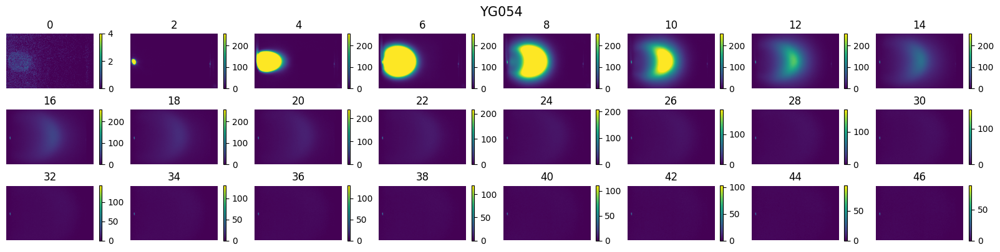

In [5]:
files = ['../../datasets/YG054_YichenGuo_06252024-test.h5',]
plume_ds_list = []
plume_list = []
for file in files:
    plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
    keys = plume_ds.dataset_names()
    print(keys)

    labels = list(np.arange(0, 48, 2))
    ds_name = file.split('/')[-1].split('_')[0]
    plumes = plume_ds.load_plumes('1-SrRuO3')
    show_images(plumes[5][labels], labels=labels, img_per_row=8, img_height=1, title=ds_name, show_colorbar=True)
    plt.show()

    plume_ds_list.append(plume_ds)
    plume_list.append(plumes)

### load plumes

['1-SrRuO3', '1-SrTiO3_Pre']


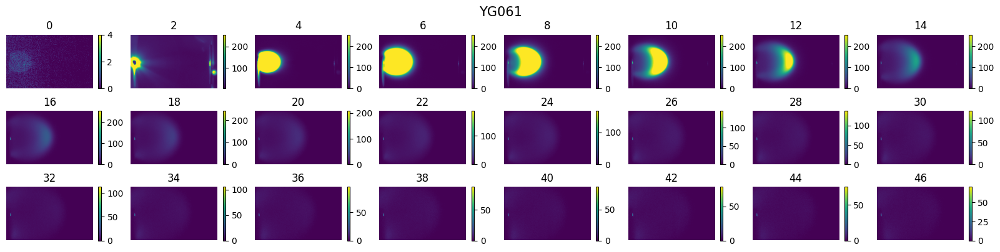

In [35]:
# files = ['../../datasets/YG045_YichenGuo_JulianGoddy_05092024.h5', '../../datasets/YG046_YichenGuo_05162024.h5', 
#          '../../datasets/YG047_YichenGuo_05172024.h5', '../../datasets/YG048_YichenGuo_05302024.h5',
#          '../../datasets/YG049_YichenGuo_06032024.h5', '../../datasets/YG050_YichenGuo_06052024.h5',
#          '../../datasets/YG051_YichenGuo_06122024.h5', '../../datasets/YG052_YichenGuo_06142024.h5',
#          '../../datasets/YG053_YichenGuo_06172024.h5', '../../datasets/YG054_YichenGuo_06252024.h5', 
#          '../../datasets/YG055_YichenGuo_06262024.h5', '../../datasets/YG056_YichenGuo_06282024.h5', 
#          '../../datasets/YG057_YichenGuo_06282024.h5', '../../datasets/YG058_YichenGuo_06292024.h5', 
#          '../../datasets/YG059_YichenGuo_07012024.h5', '../../datasets/YG060_YichenGuo_07032024.h5',]

files = ['../../datasets/YG061_YichenGuo_07042024.h5']
plume_ds_list = []
plume_list = []
for file in files:
    plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
    keys = plume_ds.dataset_names()
    print(keys)

    labels = list(np.arange(0, 48, 2))
    ds_name = file.split('/')[-1].split('_')[0]
    plumes = plume_ds.load_plumes('1-SrRuO3')
    show_images(plumes[5][labels], labels=labels, img_per_row=8, img_height=1, title=ds_name, show_colorbar=True)
    plt.show()

    plume_ds_list.append(plume_ds)
    plume_list.append(plumes)

In [4]:
files = ['../../datasets/YG045_YichenGuo_JulianGoddy_05092024.h5', '../../datasets/YG046_YichenGuo_05162024.h5', 
         '../../datasets/YG047_YichenGuo_05172024.h5', '../../datasets/YG048_YichenGuo_05302024.h5',
         '../../datasets/YG049_YichenGuo_06032024.h5', '../../datasets/YG050_YichenGuo_06052024.h5',
         '../../datasets/YG051_YichenGuo_06122024.h5', '../../datasets/YG052_YichenGuo_06142024.h5',
         '../../datasets/YG053_YichenGuo_06172024.h5', '../../datasets/YG054_YichenGuo_06252024.h5', 
         '../../datasets/YG055_YichenGuo_06262024.h5', '../../datasets/YG056_YichenGuo_06282024.h5', 
         '../../datasets/YG057_YichenGuo_06282024.h5', '../../datasets/YG058_YichenGuo_06292024.h5', 
         '../../datasets/YG059_YichenGuo_07012024.h5', '../../datasets/YG060_YichenGuo_07032024.h5', '../../datasets/YG061_YichenGuo_07042024.h5']
plume_ds_list = []
plume_list = []
for file in files:
    print(file)
    plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
    keys = plume_ds.dataset_names()
    plumes = plume_ds.load_plumes('1-SrRuO3')

    plume_ds_list.append(plume_ds)
    plume_list.append(plumes)

../../datasets/YG045_YichenGuo_JulianGoddy_05092024.h5
../../datasets/YG046_YichenGuo_05162024.h5
../../datasets/YG047_YichenGuo_05172024.h5
../../datasets/YG048_YichenGuo_05302024.h5
../../datasets/YG049_YichenGuo_06032024.h5
../../datasets/YG050_YichenGuo_06052024.h5
../../datasets/YG051_YichenGuo_06122024.h5
../../datasets/YG052_YichenGuo_06142024.h5
../../datasets/YG053_YichenGuo_06172024.h5
../../datasets/YG054_YichenGuo_06252024.h5
../../datasets/YG055_YichenGuo_06262024.h5
../../datasets/YG056_YichenGuo_06282024.h5
../../datasets/YG057_YichenGuo_06282024.h5
../../datasets/YG058_YichenGuo_06292024.h5
../../datasets/YG059_YichenGuo_07012024.h5
../../datasets/YG060_YichenGuo_07032024.h5
../../datasets/YG061_YichenGuo_07042024.h5


In [5]:
plume_ds_YG045, plume_ds_YG046, plume_ds_YG047, plume_ds_YG048, plume_ds_YG049, plume_ds_YG050, plume_ds_YG051, plume_ds_YG052, plume_ds_YG053, plume_ds_YG054, plume_ds_YG055, plumes_ds_YG056, plume_ds_YG057, plume_ds_YG058, plume_ds_YG059, plume_ds_YG060, plumes_ds_YG061 = plume_ds_list
plumes_YG045, plumes_YG046, plumes_YG047, plumes_YG048, plumes_YG049, plumes_YG050, plumes_YG051, plumes_YG052, plumes_YG053, plume_YG054, plume_YG055, plumes_YG056, plume_YG057, plume_YG058, plume_YG059, plume_YG060, plumes_YG061 = plume_list

(189, 128, 250, 400)


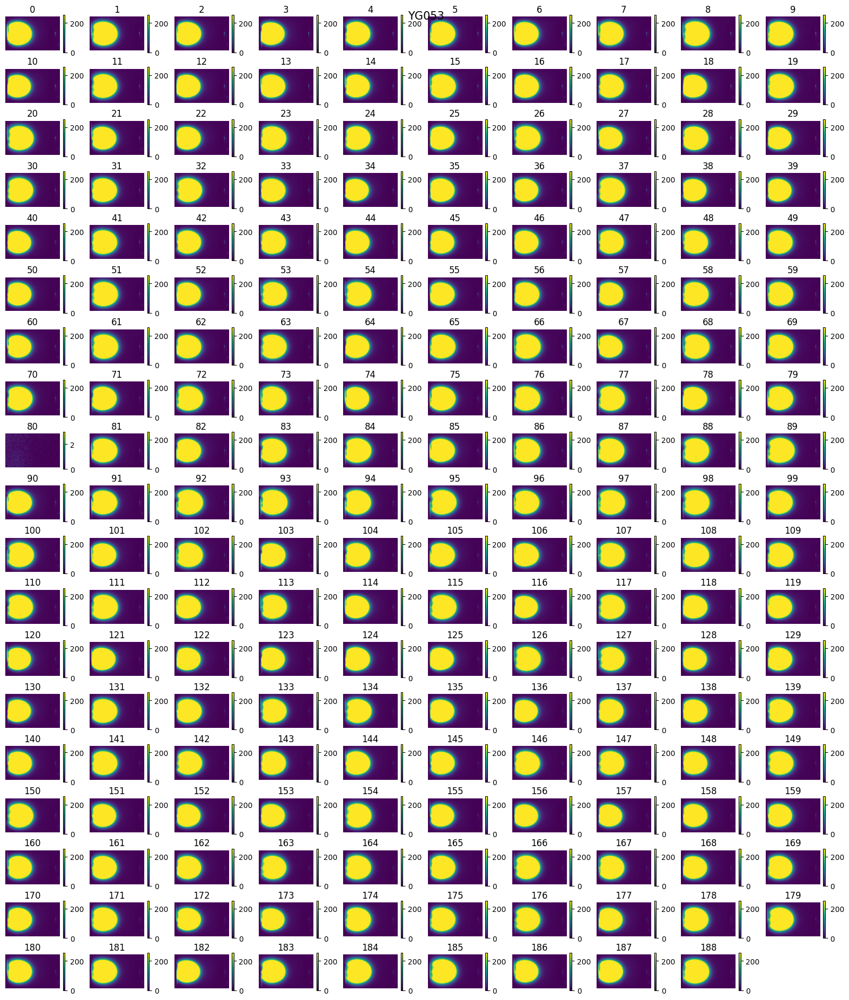

In [40]:
print(plumes_YG051.shape)
show_images(plumes_YG051[:, 6], labels=None, img_per_row=10, img_height=1, title=ds_name, show_colorbar=True)
plt.show()

## find frame normalize indicator

In [2]:
import numpy as np
import matplotlib.pyplot as plt

def visualize_corners(image: np.ndarray, coordinates: np.ndarray, color='k', marker_size=50):
    """
    Visualize corners on the given image using matplotlib, plotting only dots.
    
    Args:
    - image: NumPy array of shape (H, W, C) representing the image
    - coordinates: NumPy array of shape (N, 2) where N is the number of corners,
                   each row contains [x, y] coordinates
    - color: Color of the corner markers (default: 'r' for red)
    - marker_size: Size of the corner markers
    
    Returns:
    - matplotlib Figure object
    """
    # Create a new figure and axis
    fig, ax = plt.subplots()
    
    # Display the image
    ax.imshow(image)
    
    # Plot corner points
    ax.scatter(coordinates[:, 0], coordinates[:, 1], c=color, s=marker_size, marker='+')
    
    # Remove axis ticks
    ax.set_xticks([])
    ax.set_yticks([])
    
    return fig

imgs = []

### make h5 file

In [83]:
plumes = plume_ds_YG045.load_plumes('1-SrRuO3_Pre')
coords_YG045 = np.array([[30,51], [30,208], [375,43], [377,226]])
print(plumes.shape)

(3, 128, 250, 400)


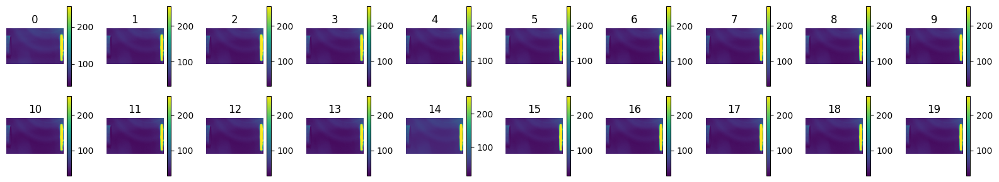

In [84]:
show_images(plumes[2, :20], labels=None, img_per_row=10, img_height=1, show_colorbar=True)
plt.show()

In [110]:
len(plume_ds_list)

8

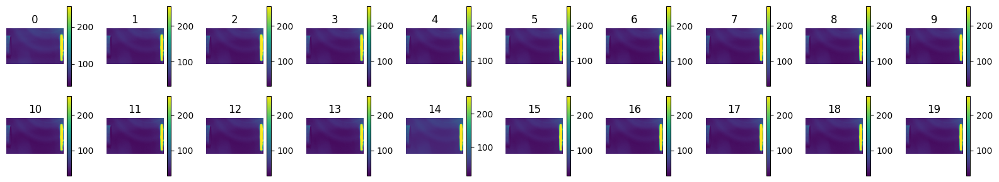

(128, 250, 400)
128


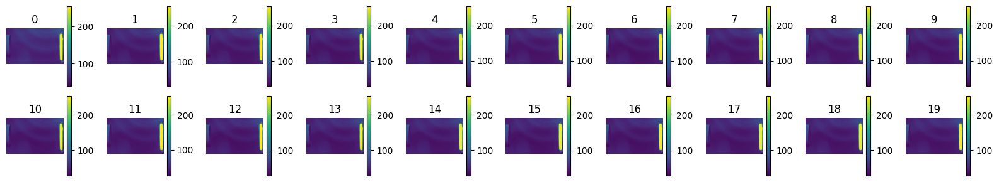

(128, 250, 400)
128


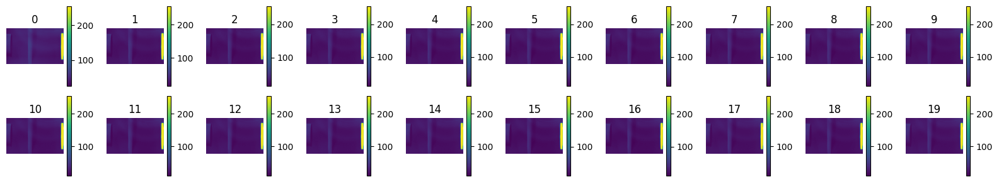

(128, 250, 400)
128


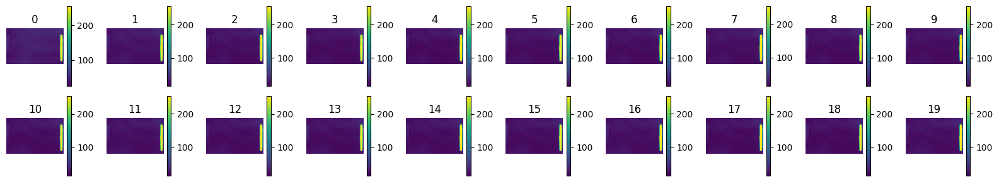

(128, 250, 400)
128


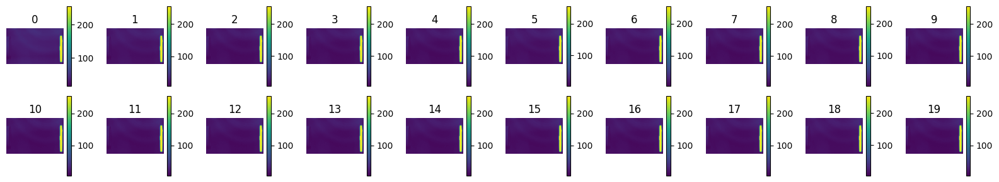

(128, 250, 400)
128


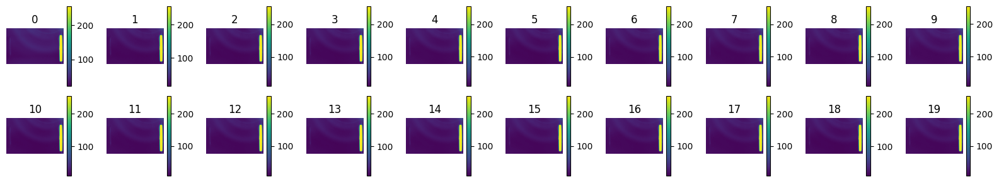

(128, 250, 400)
128


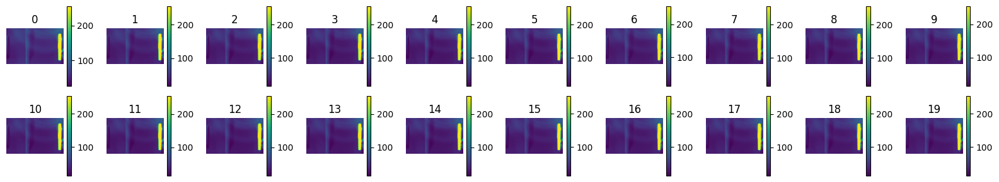

(128, 250, 400)
128


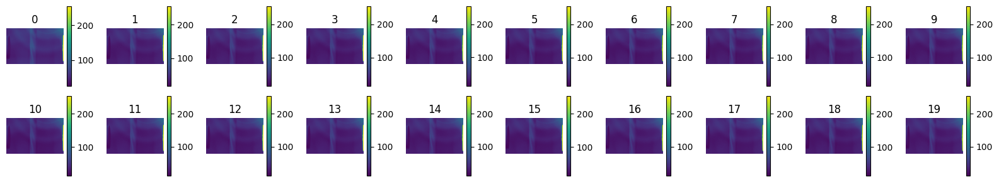

(128, 250, 400)
128


In [6]:
# Initialize empty lists to store frame views and coordinates
frame_normalizer = []
coords_list_all = []

plume_index_list = [2, 1, 0, 1, 1, 1, 1, 1]
coords_list = [[[27,46], [27,203], [372,39], [374,223]], [[36,39], [35,197], [383,34], [382,218]], [[30,50], [28,209], [376,45], [375,229]],
               [[22,58], [26,215], [374,52], [374,235]], [[25,54], [28,204], [374,48], [371,232]], [[15,52], [19,215], [363,38], [362,223]],
                [[19,52], [21,215], [396,46], [394,320]], [[14,50], [16,214], [359,44], [361,229]]]
plume_ds_list = [plume_ds_YG045, plume_ds_YG046, plume_ds_YG047, plume_ds_YG048, plume_ds_YG049, plume_ds_YG050, plume_ds_YG051, plume_ds_YG052]
for plume_ds, plume_index, coords in zip(plume_ds_list, plume_index_list, coords_list):
    imgs = plume_ds.load_plumes('1-SrRuO3_Pre')[plume_index]
    show_images(imgs[:20], labels=None, img_per_row=10, img_height=1, show_colorbar=True)
    frame_normalizer.append(imgs)
    coords_list_all.append([coords]*imgs.shape[0])
    plt.show()
    print(imgs.shape)
    print(len([coords]*imgs.shape[0]))

In [7]:
for imgs in frame_normalizer:
    print(imgs.shape)
for coords in coords_list_all:
    print(len(coords)) 

(128, 250, 400)
(128, 250, 400)
(128, 250, 400)
(128, 250, 400)
(128, 250, 400)
(128, 250, 400)
(128, 250, 400)
(128, 250, 400)
128
128
128
128
128
128
128
128


In [8]:
images = np.concatenate(frame_normalizer, axis=0)
coords = np.concatenate(coords_list_all, axis=0)
images = np.expand_dims(images, axis=-1)
print(images.shape, coords.shape)

(1024, 250, 400, 1) (1024, 4, 2)


In [29]:
with h5py.File('../../datasets/frame_normalizer.h5', 'w') as f:
    f.create_dataset('frame_normalizer', data=images)
    f.create_dataset('coords', data=coords)

In [22]:
print(images.shape, coords.shape)


(1024, 250, 400) (1024, 8)


In [20]:
coords = coords.reshape(*coords.shape[:-2], -1)
print(coords.shape)

(1024, 8)


In [28]:
import h5py
with h5py.File('../../datasets/frame_normalizer.h5', 'r') as f:
    images = f['frame_normalizer'][:]
    coords = f['coords'][:]
coords = coords.astype(np.float32)
print(images.shape, coords.shape)
print(images.dtype, coords.dtype)


(1024, 250, 400) (1024, 8)
uint8 float32


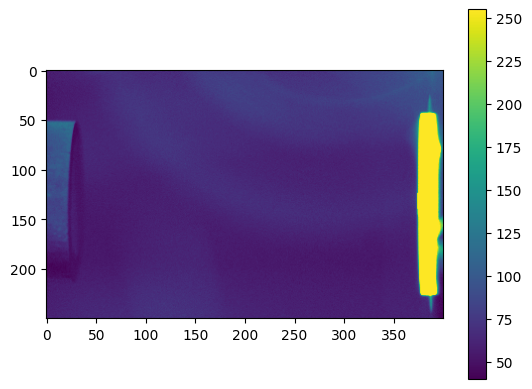

[[ 27  46]
 [ 27 203]
 [372  39]
 [374 223]]


In [10]:
plt.imshow(imgs[0, :, :, 0])
plt.colorbar()
plt.show()
print(coords[0])


In [23]:
image = imgs[0, :, :, 0]
image.shape, image.dtype

((250, 400), dtype('uint8'))

In [24]:
from PIL import Image
# Convert numpy array to PIL Image
if image.dtype != np.uint8:
    print('1')
    image = (image * 255).astype(np.uint8)
if image.ndim == 2:  # If it's a grayscale image
    print('2')
    image = Image.fromarray(image, mode='L')

    image_np = np.expand_dims(image, axis=2)  # Adds a dimension at the end
    # Convert back to PIL Image if needed
    image_expanded = Image.fromarray(image_np.squeeze(), mode='L')
    
else:
    print('3')
    image = Image.fromarray(image)

2


In [26]:
image.shape

AttributeError: 'Image' object has no attribute 'shape'

### load dataset and dataloder

In [21]:
from torchvision import transforms
from torch.utils.data import Dataset
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torchvision import transforms
from torch.utils.data import DataLoader

class hdf5_dataset(Dataset):
    
    def __init__(self, file_path, folder=None, transform=None, data_key='data', label_key='labels'):
        self.file_path = file_path
        self.folder = folder
        self.transform = transform
        self.hf = None
        self.data_key = data_key
        self.label_key = label_key

    def __len__(self):
        with h5py.File(self.file_path, 'r') as f:
            if self.folder:
                self.len = len(f[self.folder][self.label_key])
            else:
                self.len = len(f[self.label_key])
        return self.len
    
    def __getitem__(self, idx):
        if self.hf is None:
            self.hf = h5py.File(self.file_path, 'r')
        

        if self.folder:
            image = np.array(self.hf[self.folder][self.data_key][idx])
            label = np.array(self.hf[self.folder][self.label_key][idx])
        else:
            image = np.array(self.hf[self.data_key][idx])
            label = np.array(self.hf[self.label_key][idx])
            
        # Convert numpy array to PIL Image
        if image.dtype != np.uint8:
            image = (image * 255).astype(np.uint8)
        if image.ndim == 2:  # If it's a grayscale image
            image = Image.fromarray(image, mode='L')
        else:
            image = Image.fromarray(image)
        
        if self.transform:
            image = self.transform(image)
            if image.ndim == 2:
                image = image.unsqueeze(1) # expand dimension for single channel image
        
        return image, torch.tensor(label)

whole_ds = hdf5_dataset('../../../datasets/frame_normalizer.h5', transform=transforms.ToTensor(), 
                        data_key='frame_normalizer', label_key='coords')
len(whole_ds)

1024

In [2]:
whole_ds[0][0].shape, whole_ds[0][1]

(torch.Size([1, 250, 400]),
 tensor([ 27.,  46.,  27., 203., 372.,  39., 374., 223.]))

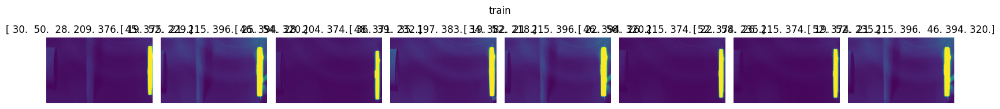

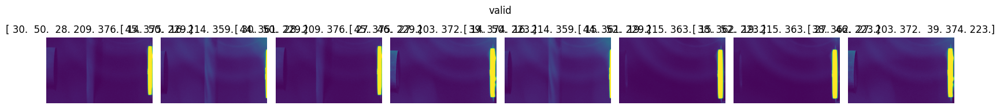

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torchvision import transforms
from torch.utils.data import DataLoader

import sys
sys.path.append('../../../../Understanding-Experimental-Images-by-Identifying-Symmetries-with-Deep-Learning/src/utils')
sys.path.append('../../../../Understanding-Experimental-Images-by-Identifying-Symmetries-with-Deep-Learning/src/benchmark')
from train_functions import train_epochs
from utils import split_train_valid, viz_dataloader, hdf5_dataset
from utils import hdf5_dataset

bs = 64
num_workers = 1

# imagenet
whole_ds = hdf5_dataset('../../../datasets/frame_normalizer.h5', transform=transforms.ToTensor(),
                        data_key='frame_normalizer', label_key='coords')
train_ds, valid_ds = split_train_valid(whole_ds, 0.8)
train_dl = DataLoader(train_ds, batch_size=bs, shuffle=True, num_workers=num_workers)
viz_dataloader(train_dl, label_converter=None, title='train')
valid_dl = DataLoader(valid_ds, batch_size=bs, shuffle=False, num_workers=num_workers)
viz_dataloader(valid_dl, label_converter=None, title='valid')

### build model

In [31]:
import torch
import torch.nn as nn

class CornerDetectionCNN(nn.Module):
    def __init__(self, num_corners):
        super(CornerDetectionCNN, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.conv4 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
        
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.adaptive_pool = nn.AdaptiveAvgPool2d((8, 8))
        
        self.fc1 = nn.Linear(128 * 8 * 8, 512)
        self.fc2 = nn.Linear(512, num_corners * 2)  # 2 coordinates per corner
        
        self.dropout = nn.Dropout(0.5)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.pool(self.relu(self.conv1(x)))
        x = self.pool(self.relu(self.conv2(x)))
        x = self.pool(self.relu(self.conv3(x)))
        x = self.relu(self.conv4(x))
        x = self.adaptive_pool(x)
        
        x = x.view(-1, 128 * 8 * 8)
        x = self.dropout(self.relu(self.fc1(x)))
        x = self.fc2(x)
        return x

# Example usage
num_corners = 4
model = CornerDetectionCNN(num_corners)

# Test with a sample input
sample_input = torch.randn(2, 1, 250, 400)  # Batch size 1, 3 color channels, 250x400 image
output = model(sample_input)
print("Output shape:", output.shape)  # Should be torch.Size([1, 8]) for 4 corners (8 coordinates)

Output shape: torch.Size([2, 8])


In [44]:
batch = next(iter(train_dl))
images, labels = batch
print(images.shape, labels.shape)
images, labels = images.to(device), labels.to(device).long()
model = model.to(device)
output = model(images)
print(output.shape, output.dtype)

torch.Size([64, 1, 250, 400]) torch.Size([64, 8])
torch.Size([64, 8]) torch.float32


In [45]:
loss = loss_func(output, labels)
print(loss.item())

48786.09375


In [39]:
loss

tensor(2771.3335, device='cuda:0', grad_fn=<DivBackward1>)

In [48]:
import os
import math
import time
import operator
import datetime
import h5py
from tqdm import tqdm

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as image

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms, models
from torch.utils.data import DataLoader, Dataset
import torchvision

def train_epochs(model, loss_func, optimizer, device, train_dl, valid_dl_list, valid_name_list,
                 epochs, start=0, scheduler=None, valid_every_epochs=1, accuracy=True, model_dir=None, tracking=False):
    
    if isinstance(valid_every_epochs, int) and valid_dl_list != []:
        valid_every_epochs = [valid_every_epochs]*len(valid_dl_list)
        
    elif isinstance(valid_every_epochs, list) and valid_dl_list == []:
        if len(valid_every_epochs) != len(valid_dl_list):
            raise ValueError("The length of valid_every_epochs should match the number of cross-validation datasets.")
    
    # make directory for the model
    if model_dir and not os.path.isdir(model_dir): 
        os.mkdir(model_dir)

    history = {'epoch':[], 'train_loss':[], 'valid_loss':[], 'train_acc':[], 'valid_acc':[]}
    if valid_dl_list != []:
        for cv_name in valid_name_list:
            history[cv_name+'_loss'] = []
        
    for epoch_idx in range(start, epochs+start):
                
        print("Epoch: {}/{}".format(epoch_idx+1, epochs+start))
        
        avg_train_loss = train(model, loss_func, optimizer, device, train_dl, 
                              scheduler=scheduler, tracking=tracking)
        print(f"Training: Loss: {avg_train_loss:.4f}")
        
        metadata = {'epoch': epoch_idx, 'train_loss': avg_train_loss}

        if valid_dl_list != []:
            for i, (cv_dl, cv_name) in enumerate(zip(valid_dl_list, valid_name_list)):
                if (epoch_idx+1) % valid_every_epochs[i] == 0: # the first element is for the validation set
                    avg_cv_loss = valid(model, loss_func, device, cv_dl, task_label=cv_name, tracking=tracking)
                    metadata[cv_name+'_loss'] = avg_cv_loss
                    print(f"{cv_name}: Loss: {avg_cv_loss:.4f}")

        if model_dir != None:
            torch.save(model.cpu(), os.path.join(model_dir, 'epoch-{}.pt'.format(epoch_idx+1)))

        # record the epoch loss and accuracy:
        for key, value in metadata.items():
            history[key].append(value)
                
    return history


def train(model, loss_func, optimizer, device, train_dl, scheduler=None, tracking=False):

    train_data_size = len(train_dl.dataset)
    start_time = time.time()

    # Set to training mode
    model.train()

    # Loss and Accuracy within the epoch
    train_loss = 0.0

    for i, batch in enumerate(tqdm(train_dl)):
        inputs = batch[0].to(device).float()
        labels = batch[1].to(device).float()
        model = model.to(device)

        # Clean existing gradients
        optimizer.zero_grad()

        # Forward pass - compute outputs on input data using the model
        outputs = model(inputs)

        # Compute loss
        loss = loss_func(outputs, labels) 

        # Compute the total loss for the batch and add it to train_loss
        train_loss += loss.item() * inputs.size(0)
        
        # Backpropagate the gradients
        loss.backward()

        # Update the parameters
        optimizer.step()
        if scheduler:
            scheduler.step()

    # Find average training loss and training accuracy
    avg_train_loss = train_loss/train_data_size 

    return avg_train_loss


def valid(model, loss_func, device, valid_dl, task_label='valid', tracking=False):

    valid_data_size = len(valid_dl.dataset)

    # Loss and Accuracy within the epoch
    valid_loss = 0.0
    valid_acc = 0.0
    
    start_time = time.time()
        
    # Validation - No gradient tracking needed
    with torch.no_grad():

        # Set to evaluation mode
        model.eval()

        # Validation loop
        
        for j, batch in enumerate(tqdm(valid_dl)):
            
            inputs = batch[0].float().to(device)
            labels = batch[1].long().to(device)

            model = model.to(device)

            # Forward pass - compute outputs on input data using the model
            outputs = model(inputs)
            
            # Compute loss
            loss = loss_func(outputs, labels) 
            
            # Compute the total loss for the batch and add it to valid_loss
            valid_loss += loss.item() * inputs.size(0)

    # Find average training loss and training accuracy
    avg_valid_loss = valid_loss/valid_data_size 

    return avg_valid_loss

In [49]:
device = torch.device('cuda:0')
lr = 1e-3
start = 0
epochs = 20

loss_func = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, epochs=epochs, max_lr=lr, steps_per_epoch=len(train_dl))
history = train_epochs(model, loss_func, optimizer, device, train_dl, valid_dl_list=[valid_dl], valid_name_list=['validation'],
                       epochs=epochs, start=start, scheduler=scheduler, valid_every_epochs=1, tracking=False)

Epoch: 1/20


100%|██████████| 13/13 [00:06<00:00,  2.05it/s]


Training: Loss: 48471.8825


100%|██████████| 4/4 [00:05<00:00,  1.30s/it]


validation: Loss: 48361.4650
Epoch: 2/20


100%|██████████| 13/13 [00:05<00:00,  2.22it/s]


Training: Loss: 48176.3264


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 47154.7361
Epoch: 3/20


100%|██████████| 13/13 [00:05<00:00,  2.26it/s]


Training: Loss: 36650.2576


100%|██████████| 4/4 [00:05<00:00,  1.30s/it]


validation: Loss: 4187.5985
Epoch: 4/20


100%|██████████| 13/13 [00:05<00:00,  2.25it/s]


Training: Loss: 5518.4797


100%|██████████| 4/4 [00:05<00:00,  1.26s/it]


validation: Loss: 1409.3039
Epoch: 5/20


100%|██████████| 13/13 [00:05<00:00,  2.26it/s]


Training: Loss: 1945.0608


100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


validation: Loss: 377.4037
Epoch: 6/20


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 1157.9760


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 197.5670
Epoch: 7/20


100%|██████████| 13/13 [00:05<00:00,  2.24it/s]


Training: Loss: 981.1345


100%|██████████| 4/4 [00:05<00:00,  1.27s/it]


validation: Loss: 161.6965
Epoch: 8/20


100%|██████████| 13/13 [00:05<00:00,  2.26it/s]


Training: Loss: 945.8781


100%|██████████| 4/4 [00:05<00:00,  1.27s/it]


validation: Loss: 195.5634
Epoch: 9/20


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 888.0352


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 165.7489
Epoch: 10/20


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 824.0382


100%|██████████| 4/4 [00:05<00:00,  1.34s/it]


validation: Loss: 151.0181
Epoch: 11/20


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 799.6885


100%|██████████| 4/4 [00:05<00:00,  1.33s/it]


validation: Loss: 205.4016
Epoch: 12/20


100%|██████████| 13/13 [00:05<00:00,  2.22it/s]


Training: Loss: 757.7540


100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


validation: Loss: 155.9918
Epoch: 13/20


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 721.6675


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 150.4757
Epoch: 14/20


100%|██████████| 13/13 [00:05<00:00,  2.17it/s]


Training: Loss: 708.1886


100%|██████████| 4/4 [00:05<00:00,  1.37s/it]


validation: Loss: 148.7623
Epoch: 15/20


100%|██████████| 13/13 [00:05<00:00,  2.24it/s]


Training: Loss: 702.8144


100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


validation: Loss: 167.3907
Epoch: 16/20


100%|██████████| 13/13 [00:05<00:00,  2.46it/s]


Training: Loss: 720.0882


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 152.3283
Epoch: 17/20


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 688.2383


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 147.9343
Epoch: 18/20


100%|██████████| 13/13 [00:05<00:00,  2.28it/s]


Training: Loss: 685.5287


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 149.5479
Epoch: 19/20


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 696.2056


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 155.5281
Epoch: 20/20


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 703.8290


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]

validation: Loss: 156.3952


In [50]:
device = torch.device('cuda:0')
lr = 1e-3
start = 20
epochs = 180

loss_func = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, epochs=epochs, max_lr=lr, steps_per_epoch=len(train_dl))
history = train_epochs(model, loss_func, optimizer, device, train_dl, valid_dl_list=[valid_dl], valid_name_list=['validation'],
                       epochs=epochs, start=start, scheduler=scheduler, valid_every_epochs=1, tracking=False)

Epoch: 21/200


100%|██████████| 13/13 [00:05<00:00,  2.38it/s]


Training: Loss: 669.7504


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 161.2065
Epoch: 22/200


100%|██████████| 13/13 [00:05<00:00,  2.36it/s]


Training: Loss: 681.3935


100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


validation: Loss: 154.1873
Epoch: 23/200


100%|██████████| 13/13 [00:05<00:00,  2.38it/s]


Training: Loss: 681.2359


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 168.4683
Epoch: 24/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 677.3078


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 149.1309
Epoch: 25/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 707.8075


100%|██████████| 4/4 [00:04<00:00,  1.21s/it]


validation: Loss: 184.2191
Epoch: 26/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 685.8157


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 145.8948
Epoch: 27/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 664.5537


100%|██████████| 4/4 [00:04<00:00,  1.21s/it]


validation: Loss: 145.2798
Epoch: 28/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 653.1099


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 196.6275
Epoch: 29/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 632.2677


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 148.6771
Epoch: 30/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 633.6629


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 158.0330
Epoch: 31/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 621.2438


100%|██████████| 4/4 [00:04<00:00,  1.21s/it]


validation: Loss: 145.1567
Epoch: 32/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 632.1803


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 145.9635
Epoch: 33/200


100%|██████████| 13/13 [00:05<00:00,  2.38it/s]


Training: Loss: 599.9590


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 163.2508
Epoch: 34/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 630.6500


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 174.7101
Epoch: 35/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 610.3767


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 158.9975
Epoch: 36/200


100%|██████████| 13/13 [00:05<00:00,  2.27it/s]


Training: Loss: 631.4676


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 159.5717
Epoch: 37/200


100%|██████████| 13/13 [00:05<00:00,  2.27it/s]


Training: Loss: 588.2462


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 218.7088
Epoch: 38/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 566.3361


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 183.0295
Epoch: 39/200


100%|██████████| 13/13 [00:05<00:00,  2.40it/s]


Training: Loss: 556.7350


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 162.9454
Epoch: 40/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 513.3371


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 142.7196
Epoch: 41/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 502.7482


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 154.3675
Epoch: 42/200


100%|██████████| 13/13 [00:05<00:00,  2.36it/s]


Training: Loss: 524.9874


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 249.3174
Epoch: 43/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 548.6718


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 195.0454
Epoch: 44/200


100%|██████████| 13/13 [00:05<00:00,  2.40it/s]


Training: Loss: 533.2247


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 150.8724
Epoch: 45/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 497.2310


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 142.8723
Epoch: 46/200


100%|██████████| 13/13 [00:05<00:00,  2.27it/s]


Training: Loss: 515.1355


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 155.7452
Epoch: 47/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 491.8071


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 140.7380
Epoch: 48/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 543.2251


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 197.2696
Epoch: 49/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 494.0066


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 254.7763
Epoch: 50/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 581.0895


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 173.1082
Epoch: 51/200


100%|██████████| 13/13 [00:05<00:00,  2.28it/s]


Training: Loss: 506.3614


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 138.6031
Epoch: 52/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 472.0896


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 373.2386
Epoch: 53/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 579.2878


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 346.6387
Epoch: 54/200


100%|██████████| 13/13 [00:05<00:00,  2.38it/s]


Training: Loss: 568.9743


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 190.7332
Epoch: 55/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 463.6680


100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


validation: Loss: 211.1136
Epoch: 56/200


100%|██████████| 13/13 [00:05<00:00,  2.40it/s]


Training: Loss: 491.2349


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 140.7454
Epoch: 57/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 530.1093


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 196.5661
Epoch: 58/200


100%|██████████| 13/13 [00:05<00:00,  2.28it/s]


Training: Loss: 487.7052


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 139.7976
Epoch: 59/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 492.2832


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 134.2630
Epoch: 60/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 494.2877


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 197.7697
Epoch: 61/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 467.2270


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 143.0639
Epoch: 62/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 493.2351


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 146.4183
Epoch: 63/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 626.2770


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 247.8767
Epoch: 64/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 498.1027


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 288.9327
Epoch: 65/200


100%|██████████| 13/13 [00:05<00:00,  2.36it/s]


Training: Loss: 484.8979


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 134.3589
Epoch: 66/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 511.1320


100%|██████████| 4/4 [00:05<00:00,  1.25s/it]


validation: Loss: 133.3925
Epoch: 67/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 458.1912


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 137.0017
Epoch: 68/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 477.1003


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 160.4864
Epoch: 69/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 415.2484


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 143.1099
Epoch: 70/200


100%|██████████| 13/13 [00:05<00:00,  2.38it/s]


Training: Loss: 477.0581


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 237.3814
Epoch: 71/200


100%|██████████| 13/13 [00:05<00:00,  2.39it/s]


Training: Loss: 516.4363


100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


validation: Loss: 289.2183
Epoch: 72/200


100%|██████████| 13/13 [00:05<00:00,  2.39it/s]


Training: Loss: 465.5297


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 125.3039
Epoch: 73/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 448.5553


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 129.0143
Epoch: 74/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 505.5673


100%|██████████| 4/4 [00:05<00:00,  1.25s/it]


validation: Loss: 576.5585
Epoch: 75/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 605.8844


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 308.8048
Epoch: 76/200


100%|██████████| 13/13 [00:05<00:00,  2.39it/s]


Training: Loss: 479.7588


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 120.3901
Epoch: 77/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 539.5486


100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


validation: Loss: 288.0671
Epoch: 78/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 486.3317


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 128.8579
Epoch: 79/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 540.5368


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 281.0771
Epoch: 80/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 585.5849


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 268.3069
Epoch: 81/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 525.6784


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 119.1918
Epoch: 82/200


100%|██████████| 13/13 [00:05<00:00,  2.38it/s]


Training: Loss: 467.5721


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 280.2940
Epoch: 83/200


100%|██████████| 13/13 [00:05<00:00,  2.27it/s]


Training: Loss: 547.5489


100%|██████████| 4/4 [00:05<00:00,  1.27s/it]


validation: Loss: 384.5865
Epoch: 84/200


100%|██████████| 13/13 [00:05<00:00,  2.40it/s]


Training: Loss: 486.2740


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 167.4833
Epoch: 85/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 433.8840


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 149.0755
Epoch: 86/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 470.3298


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 322.1945
Epoch: 87/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 478.2478


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 116.4245
Epoch: 88/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 443.3227


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 127.7285
Epoch: 89/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 437.2246


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 273.7592
Epoch: 90/200


100%|██████████| 13/13 [00:05<00:00,  2.28it/s]


Training: Loss: 519.4635


100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


validation: Loss: 193.9087
Epoch: 91/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 486.0449


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 143.3132
Epoch: 92/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 426.0641


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 150.9695
Epoch: 93/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 449.0712


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 188.5903
Epoch: 94/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 441.6472


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 111.9868
Epoch: 95/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 465.7456


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 210.1132
Epoch: 96/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 460.1749


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 272.5067
Epoch: 97/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 511.3384


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 240.5523
Epoch: 98/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 480.2841


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 172.3781
Epoch: 99/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 470.4862


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 198.8603
Epoch: 100/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 474.2827


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 185.6607
Epoch: 101/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 497.9863


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 106.4287
Epoch: 102/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 430.8758


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 119.4756
Epoch: 103/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 440.4474


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 225.9210
Epoch: 104/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 406.9181


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 104.7601
Epoch: 105/200


100%|██████████| 13/13 [00:05<00:00,  2.28it/s]


Training: Loss: 444.7884


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 126.1894
Epoch: 106/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 419.9879


100%|██████████| 4/4 [00:05<00:00,  1.26s/it]


validation: Loss: 108.0059
Epoch: 107/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 398.6144


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 106.3732
Epoch: 108/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 383.9243


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 129.4322
Epoch: 109/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 375.1222


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 115.5852
Epoch: 110/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 425.7494


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 213.8832
Epoch: 111/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 490.5700


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 106.5557
Epoch: 112/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 437.0563


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 251.2173
Epoch: 113/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 459.7851


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 107.7971
Epoch: 114/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 463.7871


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 108.3511
Epoch: 115/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 416.6760


100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


validation: Loss: 113.4889
Epoch: 116/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 412.1201


100%|██████████| 4/4 [00:05<00:00,  1.30s/it]


validation: Loss: 133.8705
Epoch: 117/200


100%|██████████| 13/13 [00:05<00:00,  2.36it/s]


Training: Loss: 379.5005


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 104.4316
Epoch: 118/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 413.0099


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 120.2310
Epoch: 119/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 450.4736


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 110.0715
Epoch: 120/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 437.9299


100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


validation: Loss: 104.5630
Epoch: 121/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 446.3730


100%|██████████| 4/4 [00:05<00:00,  1.31s/it]


validation: Loss: 214.4698
Epoch: 122/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 417.6576


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 102.7191
Epoch: 123/200


100%|██████████| 13/13 [00:05<00:00,  2.36it/s]


Training: Loss: 391.3109


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 105.2357
Epoch: 124/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 404.2673


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 107.1884
Epoch: 125/200


100%|██████████| 13/13 [00:05<00:00,  2.36it/s]


Training: Loss: 389.1414


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 134.5472
Epoch: 126/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 401.2638


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 137.0681
Epoch: 127/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 393.1058


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 103.1850
Epoch: 128/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 400.2426


100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


validation: Loss: 111.1063
Epoch: 129/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 415.6501


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 109.5257
Epoch: 130/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 422.8261


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 107.8816
Epoch: 131/200


100%|██████████| 13/13 [00:05<00:00,  2.27it/s]


Training: Loss: 402.9625


100%|██████████| 4/4 [00:05<00:00,  1.27s/it]


validation: Loss: 102.6473
Epoch: 132/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 404.4548


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 107.3349
Epoch: 133/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 450.9758


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 129.6700
Epoch: 134/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 447.2062


100%|██████████| 4/4 [00:04<00:00,  1.21s/it]


validation: Loss: 238.2298
Epoch: 135/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 415.3632


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 150.4175
Epoch: 136/200


100%|██████████| 13/13 [00:05<00:00,  2.38it/s]


Training: Loss: 381.6364


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 105.6984
Epoch: 137/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 427.2616


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 187.1576
Epoch: 138/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 420.5978


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 148.0979
Epoch: 139/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 445.4880


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 153.6288
Epoch: 140/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 425.2677


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 158.8239
Epoch: 141/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 441.0499


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 141.4030
Epoch: 142/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 437.9904


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 123.0040
Epoch: 143/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 470.9574


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 224.1616
Epoch: 144/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 432.0360


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 103.0242
Epoch: 145/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 385.1196


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 103.9911
Epoch: 146/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 416.8465


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 196.4567
Epoch: 147/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 419.9848


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 104.5206
Epoch: 148/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 405.0454


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 110.8799
Epoch: 149/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 407.0985


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 109.2315
Epoch: 150/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 432.2072


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 132.7733
Epoch: 151/200


100%|██████████| 13/13 [00:05<00:00,  2.36it/s]


Training: Loss: 420.7872


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 100.9445
Epoch: 152/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 397.9666


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 102.6147
Epoch: 153/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 377.4548


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 105.1746
Epoch: 154/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 362.7879


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 100.2603
Epoch: 155/200


100%|██████████| 13/13 [00:05<00:00,  2.28it/s]


Training: Loss: 363.7411


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 100.1268
Epoch: 156/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 365.4522


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 101.8781
Epoch: 157/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 422.5129


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 123.4478
Epoch: 158/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 380.9413


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 103.8058
Epoch: 159/200


100%|██████████| 13/13 [00:05<00:00,  2.36it/s]


Training: Loss: 390.7456


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 100.6224
Epoch: 160/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 399.2227


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 132.9863
Epoch: 161/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 406.8313


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 99.9164
Epoch: 162/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 406.9674


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 108.7147
Epoch: 163/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 396.8559


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 100.2484
Epoch: 164/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 403.7861


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 105.4845
Epoch: 165/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 390.0485


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 100.7681
Epoch: 166/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 426.5674


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 99.6327
Epoch: 167/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 376.5591


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 122.9506
Epoch: 168/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 402.8910


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 99.8475
Epoch: 169/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 389.3659


100%|██████████| 4/4 [00:04<00:00,  1.21s/it]


validation: Loss: 105.6653
Epoch: 170/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 387.7311


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 99.5592
Epoch: 171/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 369.0883


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 109.9405
Epoch: 172/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 384.6955


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 105.2513
Epoch: 173/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 376.2769


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 115.6973
Epoch: 174/200


100%|██████████| 13/13 [00:05<00:00,  2.36it/s]


Training: Loss: 400.1722


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 100.7313
Epoch: 175/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 390.3472


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 110.0870
Epoch: 176/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 391.9641


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 99.1534
Epoch: 177/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 366.5358


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 100.3250
Epoch: 178/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 385.0935


100%|██████████| 4/4 [00:05<00:00,  1.27s/it]


validation: Loss: 99.0632
Epoch: 179/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 403.1841


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 108.8845
Epoch: 180/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 392.0804


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 99.6306
Epoch: 181/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 395.7935


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 109.2360
Epoch: 182/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 381.1899


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 100.7489
Epoch: 183/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 392.3052


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 98.9886
Epoch: 184/200


100%|██████████| 13/13 [00:05<00:00,  2.37it/s]


Training: Loss: 381.6291


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 101.4851
Epoch: 185/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 389.1656


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 100.0040
Epoch: 186/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 398.7107


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 101.4334
Epoch: 187/200


100%|██████████| 13/13 [00:05<00:00,  2.30it/s]


Training: Loss: 371.4296


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 99.8104
Epoch: 188/200


100%|██████████| 13/13 [00:05<00:00,  2.32it/s]


Training: Loss: 361.7469


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 99.0880
Epoch: 189/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 364.0023


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 105.6725
Epoch: 190/200


100%|██████████| 13/13 [00:05<00:00,  2.38it/s]


Training: Loss: 391.4341


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 100.7165
Epoch: 191/200


100%|██████████| 13/13 [00:05<00:00,  2.29it/s]


Training: Loss: 396.1789


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 99.2250
Epoch: 192/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 393.1235


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 99.0474
Epoch: 193/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 393.6700


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]


validation: Loss: 99.0133
Epoch: 194/200


100%|██████████| 13/13 [00:05<00:00,  2.28it/s]


Training: Loss: 406.7530


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 99.0895
Epoch: 195/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 386.1191


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 99.1920
Epoch: 196/200


100%|██████████| 13/13 [00:05<00:00,  2.35it/s]


Training: Loss: 390.5750


100%|██████████| 4/4 [00:04<00:00,  1.22s/it]


validation: Loss: 99.5589
Epoch: 197/200


100%|██████████| 13/13 [00:05<00:00,  2.36it/s]


Training: Loss: 386.6167


100%|██████████| 4/4 [00:05<00:00,  1.25s/it]


validation: Loss: 100.0787
Epoch: 198/200


100%|██████████| 13/13 [00:05<00:00,  2.34it/s]


Training: Loss: 374.4914


100%|██████████| 4/4 [00:04<00:00,  1.25s/it]


validation: Loss: 100.4915
Epoch: 199/200


100%|██████████| 13/13 [00:05<00:00,  2.33it/s]


Training: Loss: 383.6863


100%|██████████| 4/4 [00:04<00:00,  1.24s/it]


validation: Loss: 100.5907
Epoch: 200/200


100%|██████████| 13/13 [00:05<00:00,  2.31it/s]


Training: Loss: 387.3346


100%|██████████| 4/4 [00:04<00:00,  1.23s/it]

validation: Loss: 100.5923


In [51]:
device = torch.device('cuda:0')
lr = 1e-3
start = 200
epochs = 10

loss_func = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, epochs=epochs, max_lr=lr, steps_per_epoch=len(train_dl))
history = train_epochs(model, loss_func, optimizer, device, train_dl, valid_dl_list=[valid_dl], valid_name_list=['validation'],
                       epochs=epochs, start=start, scheduler=scheduler, valid_every_epochs=1, tracking=False)

Epoch: 201/210


100%|██████████| 13/13 [00:06<00:00,  2.14it/s]


Training: Loss: 396.2802


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 103.6104
Epoch: 202/210


100%|██████████| 13/13 [00:05<00:00,  2.21it/s]


Training: Loss: 416.2905


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 98.9682
Epoch: 203/210


100%|██████████| 13/13 [00:05<00:00,  2.26it/s]


Training: Loss: 427.3226


100%|██████████| 4/4 [00:05<00:00,  1.30s/it]


validation: Loss: 138.0852
Epoch: 204/210


100%|██████████| 13/13 [00:05<00:00,  2.25it/s]


Training: Loss: 438.6907


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 109.0570
Epoch: 205/210


100%|██████████| 13/13 [00:05<00:00,  2.21it/s]


Training: Loss: 436.5628


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]


validation: Loss: 120.1155
Epoch: 206/210


100%|██████████| 13/13 [00:05<00:00,  2.26it/s]


Training: Loss: 433.3785


100%|██████████| 4/4 [00:05<00:00,  1.30s/it]


validation: Loss: 98.5537
Epoch: 207/210


100%|██████████| 13/13 [00:05<00:00,  2.26it/s]


Training: Loss: 423.3325


100%|██████████| 4/4 [00:05<00:00,  1.27s/it]


validation: Loss: 200.1000
Epoch: 208/210


100%|██████████| 13/13 [00:05<00:00,  2.26it/s]


Training: Loss: 396.2518


100%|██████████| 4/4 [00:05<00:00,  1.27s/it]


validation: Loss: 138.8291
Epoch: 209/210


100%|██████████| 13/13 [00:05<00:00,  2.27it/s]


Training: Loss: 401.1405


100%|██████████| 4/4 [00:05<00:00,  1.26s/it]


validation: Loss: 100.0557
Epoch: 210/210


100%|██████████| 13/13 [00:05<00:00,  2.26it/s]


Training: Loss: 385.3980


100%|██████████| 4/4 [00:05<00:00,  1.29s/it]

validation: Loss: 100.9200


In [52]:
torch.save(model, '../../datasets/corner_detection_cnn.pt')

In [92]:

# YG046
imgs = plume_ds_YG046.load_plumes('1-SrRuO3_Pre')[1]
frame_normalizer.append(imgs)
coords_list.append([[[27,46], [27,203], [372,39], [374,223]]]*imgs.shape[0])

# YG047
imgs = plume_ds_YG047.load_plumes('1-SrRuO3_Pre')[1]
frame_normalizer.append(imgs)
coords_list.append([[[36,39], [35,197], [383,34], [382,218]]]*imgs.shape[0])

# YG048
imgs = plume_ds_YG048.load_plumes('1-SrRuO3_Pre')[1]
frame_normalizer.append(imgs)
coords_list.append([[[30,50], [28,209], [376,45], [375,229]]]*imgs.shape[0])

# YG049
imgs = plume_ds_YG049.load_plumes('1-SrRuO3_Pre')[1]
frame_normalizer.append(imgs)
coords_list.append([[[22,58], [26,215], [374,52], [374,235]]]*imgs.shape[0])

# YG050
imgs = plume_ds_YG050.load_plumes('1-SrRuO3_Pre')[1]
frame_normalizer.append(imgs)
coords_list.append([[[25,54], [28,204], [374,48], [371,232]]]*imgs.shape[0])

# YG051
imgs = plume_ds_YG051.load_plumes('1-SrRuO3_Pre')[1]
frame_normalizer.append(imgs)
coords_list.append([[[15,52], [19,215], [363,38], [362,223]]]*imgs.shape[0])

# YG052
imgs = plume_ds_YG052.load_plumes('1-SrRuO3_Pre')[1]
frame_normalizer.append(imgs)
coords_list.append([[[19,52], [21,215], [396,46], [394,320]]]*imgs.shape[0])

# YG053
imgs = plume_ds_YG053.load_plumes('1-SrRuO3_Pre')[1]
frame_normalizer.append(imgs)
coords_list.append([[[14,50], [16,214], [359,44], [361,229]]]*imgs.shape[0])

images = np.concatenate(frame_normalizer, axis=0)
coords = np.concatenate(coords_list, axis=0)
print(images.shape, coords.shape)

(1024, 250, 400) (1024, 4, 2)


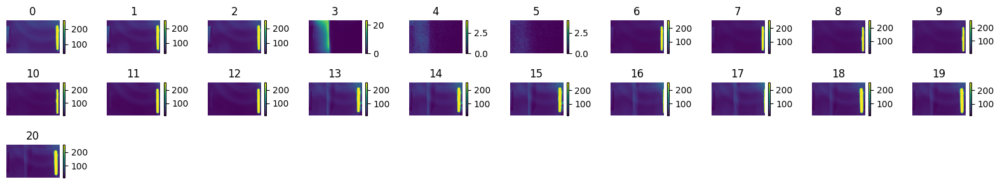

In [95]:
show_images(images[::50], labels=None, img_per_row=10, img_height=1, show_colorbar=True)
plt.show()

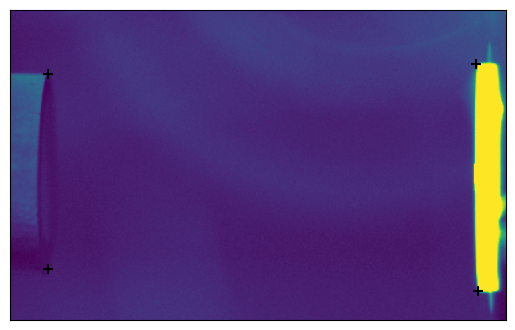

In [71]:
frame_view_YG045 = plume_ds_YG045.load_plumes('1-SrRuO3_Pre')[2][0]
coords_YG045 = np.array([[30,51], [30,208], [375,43], [377,226]])

fig = visualize_corners(frame_view_YG045, coords_YG045)
plt.show()

In [54]:
frame_view_YG045 = plume_ds_YG045.load_plumes('1-SrRuO3_Pre')[2][0]
coords_YG045 = np.array([[30,51], [30,208], [375,43], [377,226]])
px.imshow(frame_view_YG045)

In [40]:
frame_view_YG046 = plume_ds_YG046.load_plumes('1-SrRuO3_Pre')[1][1]
coords_YG046 = np.array([[27,46], [27,203], [372,39], [374,223]])
px.imshow(frame_view_YG046)

In [41]:
frame_view_YG047 = plume_ds_YG047.load_plumes('1-SrRuO3_Pre')[0][0]
coords_YG047 = np.array([[36,39], [35,197], [383,34], [382,218]])
px.imshow(frame_view_YG047)

In [42]:
frame_view_YG048 = plume_ds_YG048.load_plumes('1-SrRuO3_Pre')[1][1]
coords_YG048 = np.array([[30,50], [28,209], [376,45], [375,229]])
px.imshow(frame_view_YG048)

In [43]:
frame_view_YG049 = plume_ds_YG049.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG049 = np.array([[22,58], [26,215], [374,52], [374,235]])
px.imshow(frame_view_YG049)

In [44]:
frame_view_YG050 = plume_ds_YG050.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG050 = np.array([[25,54], [28,204], [374,48], [371,232]])
px.imshow(frame_view_YG050)

In [45]:
frame_view_YG051 = plume_ds_YG051.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG051 = np.array([[15,52], [19,215], [363,38], [362,223]])
px.imshow(frame_view_YG051)

In [48]:
frame_view_YG052 = plume_ds_YG052.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG052 = np.array([[19,52], [21,215], [396,46], [394,320]])
px.imshow(frame_view_YG052)

In [86]:
frame_view_YG053 = plume_ds_YG053.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG053 = np.array([[14,50], [16,214], [359,44], [361,229]])
px.imshow(frame_view_YG053)

In [87]:
frame_view_YG054 = plume_ds_YG054.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG054 = np.array([[14,55], [15,217], [357,48], [360,234]])
px.imshow(frame_view_YG054)

In [88]:
frame_view_YG055 = plume_ds_YG055.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG055 = np.array([[17,46], [19,208], [366,39], [364,222]])
px.imshow(frame_view_YG055)

## analyze plumes

### parse df

In [25]:
# analysis frame parameters
start_position = (30, (51+208)//2) # start position of plume 
position_range = (30, 376) # x position range
threshold = 20
time_interval = 500e-9  # 500ns

# visualize parameters
index = 3
# x_range = (8, 82) # x_range of frames to visualize
viz_index = list(np.arange(0, 32, 1))

P = PlumeMetrics(time_interval, threshold=threshold)
V = VelocityCalculator(time_interval, position_range, start_position, threshold=threshold)

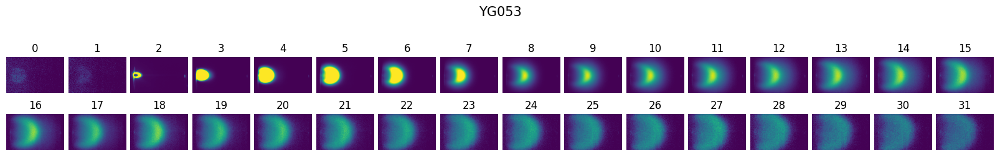

100%|██████████| 156/156 [00:22<00:00,  6.81it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


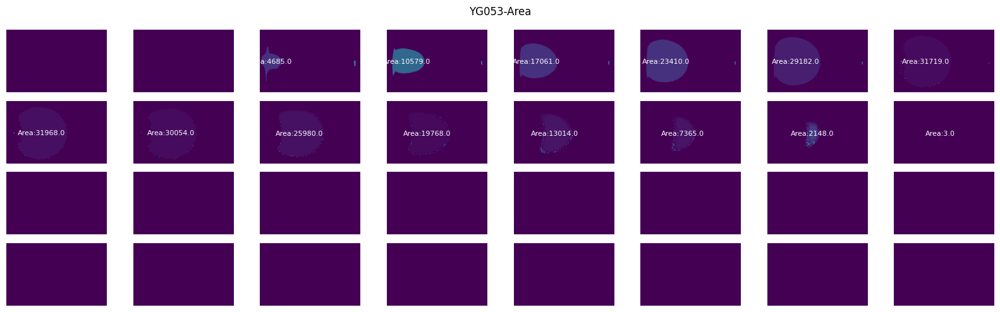

100%|██████████| 156/156 [00:15<00:00, 10.28it/s]


(32, 250, 400) (32, 2) (32,) (32,)


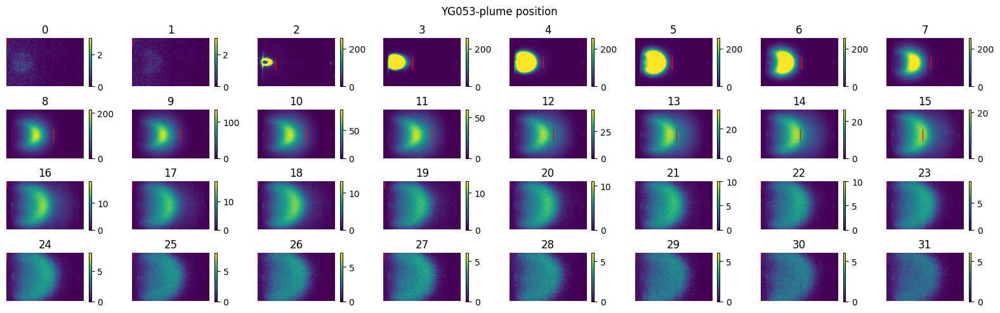

In [26]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG045 = analyze_function(P, V, plumes_YG045, threshold, index, viz_index, ds_name, align_parms={'align':False, 'coords':coords_YG045, 'coords_standard':coords_YG045})
df_YG045['Growth'] = 'YG045'

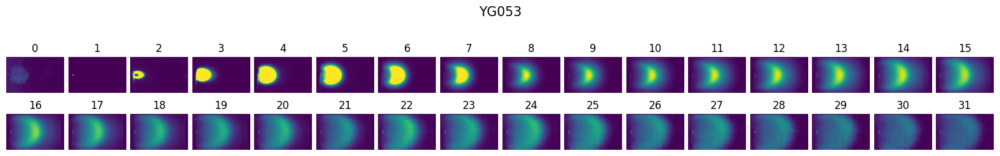

100%|██████████| 125/125 [00:15<00:00,  8.15it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


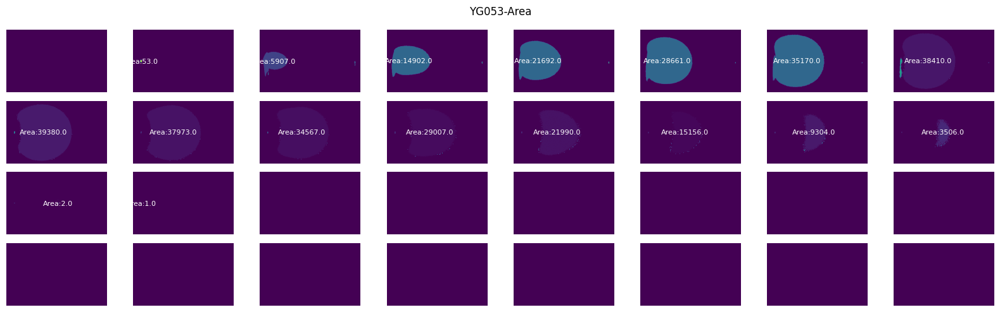

100%|██████████| 125/125 [00:10<00:00, 11.97it/s]


(32, 250, 400) (32, 2) (32,) (32,)


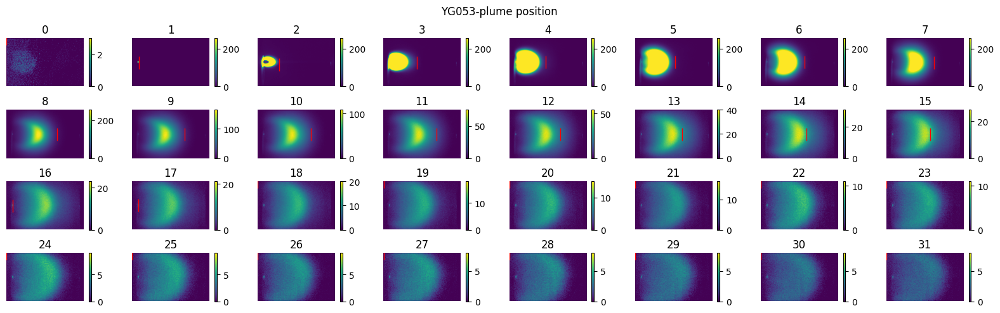

In [27]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG046 = analyze_function(P, V, plumes_YG046, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG046, 'coords_standard':coords_YG045})
df_YG046['Growth'] = 'YG046'

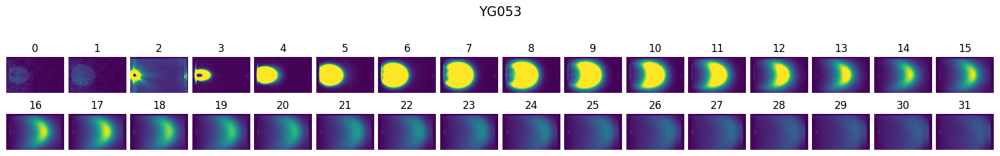

100%|██████████| 94/94 [00:14<00:00,  6.63it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


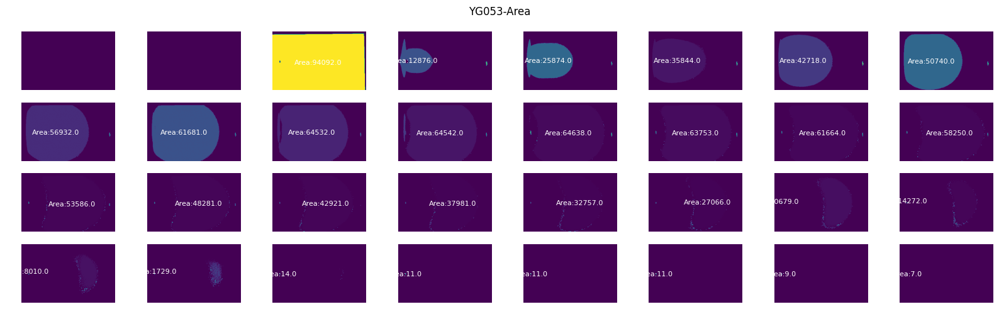

100%|██████████| 94/94 [00:19<00:00,  4.71it/s]


(32, 250, 400) (32, 2) (32,) (32,)


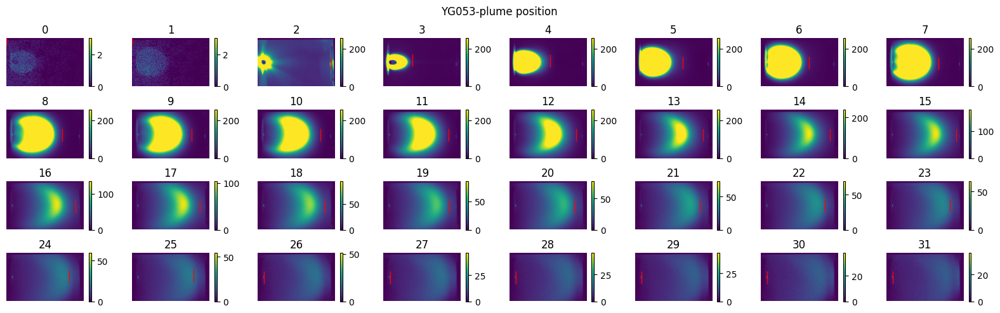

In [28]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG047 = analyze_function(P, V, plumes_YG047, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG047, 'coords_standard':coords_YG045})
df_YG047['Growth'] = 'YG047'

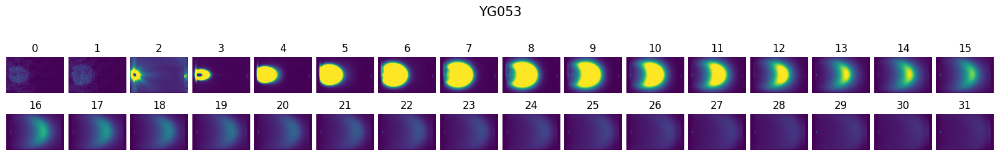

100%|██████████| 189/189 [00:28<00:00,  6.54it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


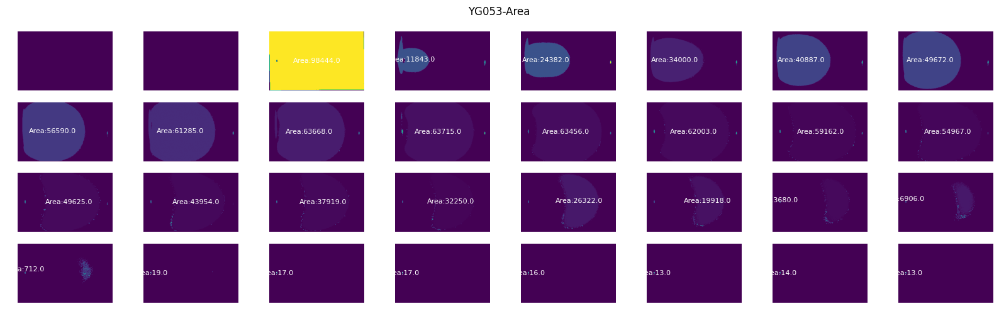

100%|██████████| 189/189 [00:37<00:00,  5.03it/s]


(32, 250, 400) (32, 2) (32,) (32,)


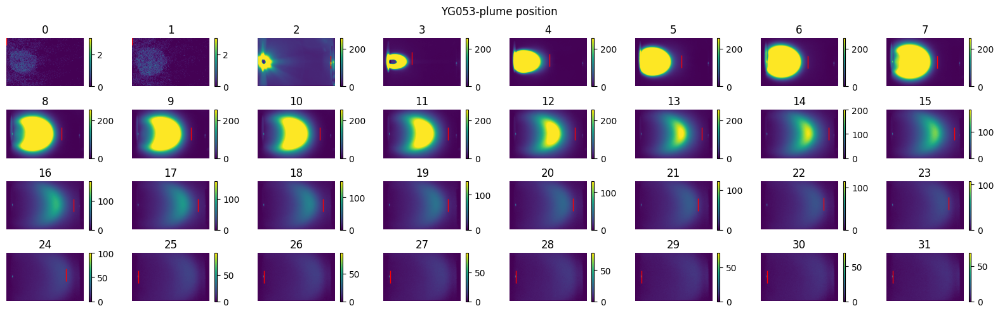

In [29]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG048 = analyze_function(P, V, plumes_YG048, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG048, 'coords_standard':coords_YG045})
df_YG048['Growth'] = 'YG048'

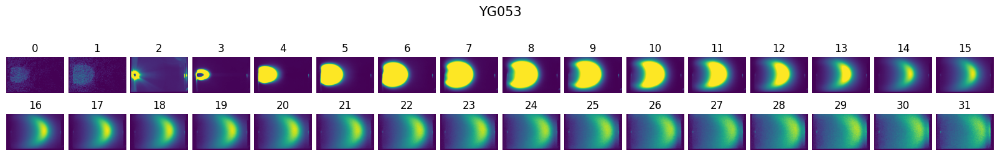

100%|██████████| 459/459 [01:11<00:00,  6.43it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


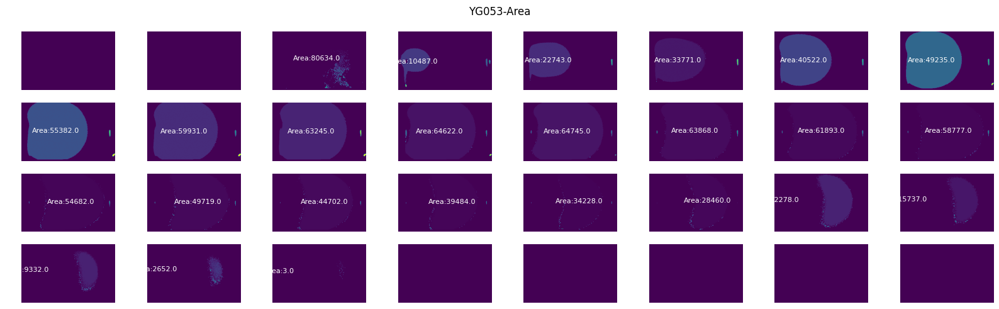

100%|██████████| 459/459 [01:30<00:00,  5.07it/s]


(32, 250, 400) (32, 2) (32,) (32,)


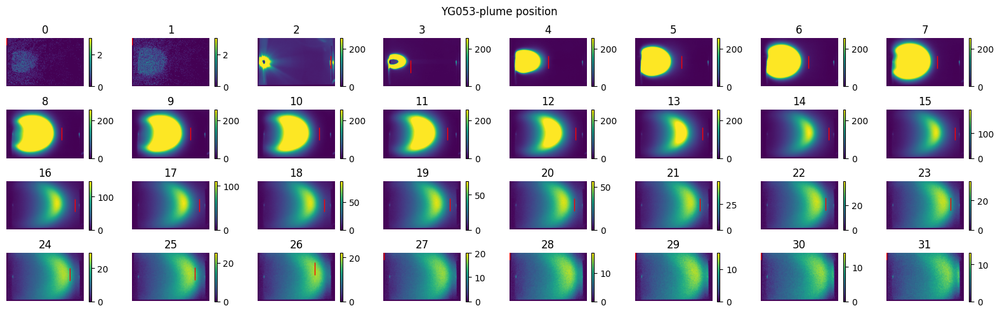

In [30]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG049 = analyze_function(P, V, plumes_YG049, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG049, 'coords_standard':coords_YG045})
df_YG049['Growth'] = 'YG049'

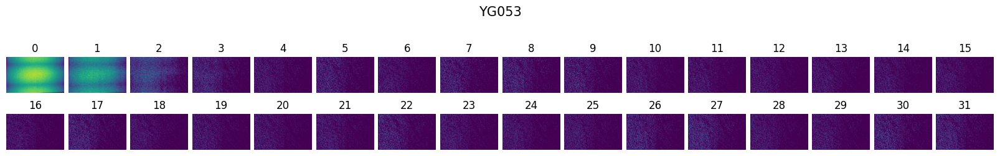

100%|██████████| 189/189 [00:24<00:00,  7.65it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


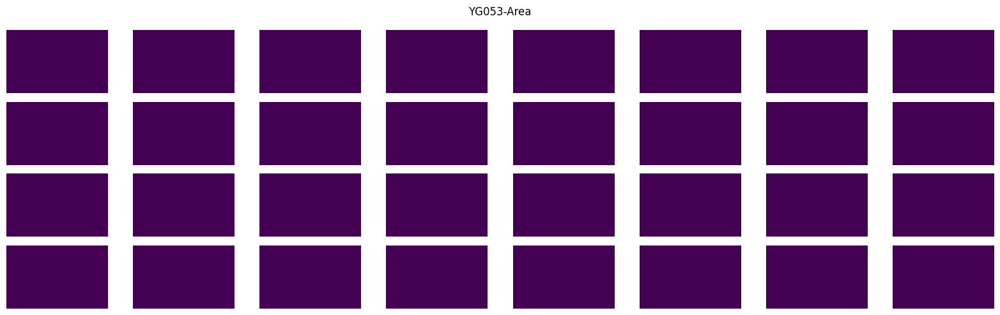

100%|██████████| 189/189 [00:36<00:00,  5.23it/s]


(32, 250, 400) (32, 2) (32,) (32,)


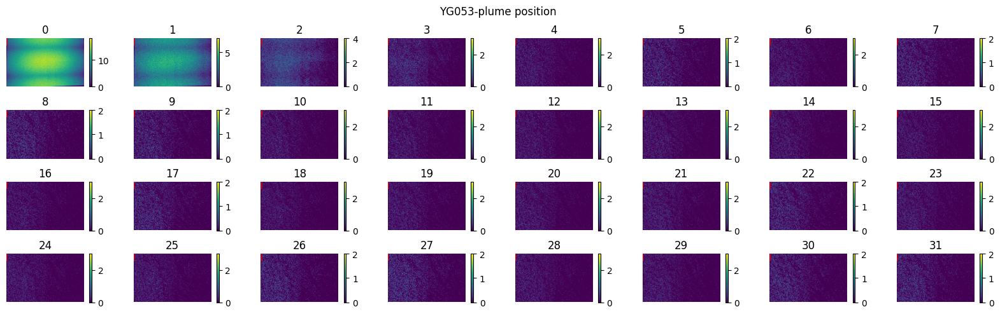

In [31]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG050 = analyze_function(P, V, plumes_YG050, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG050, 'coords_standard':coords_YG045})
df_YG050['Growth'] = 'YG050'

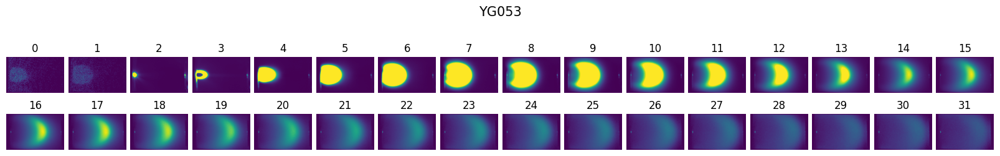

100%|██████████| 189/189 [00:27<00:00,  6.86it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


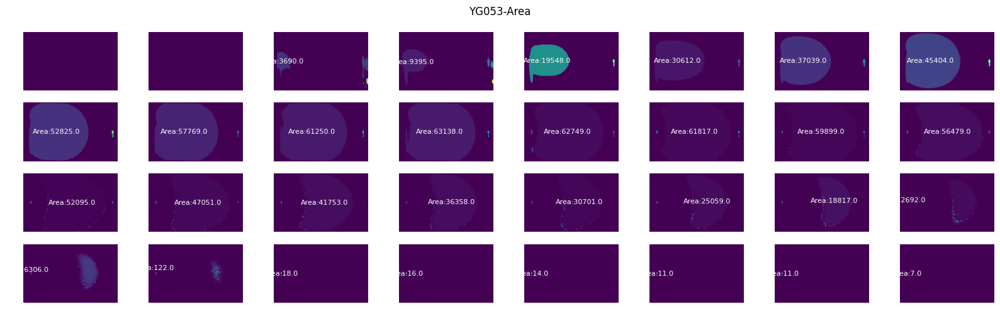

100%|██████████| 189/189 [00:32<00:00,  5.86it/s]


(32, 250, 400) (32, 2) (32,) (32,)


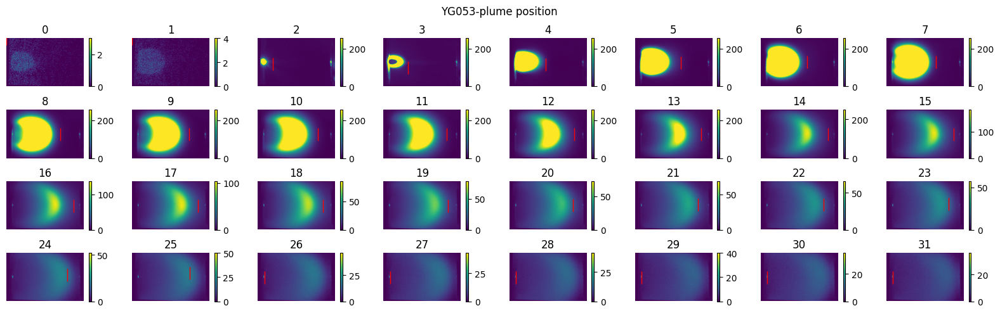

In [32]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG051 = analyze_function(P, V, plumes_YG051, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG051, 'coords_standard':coords_YG045})
df_YG051['Growth'] = 'YG051'

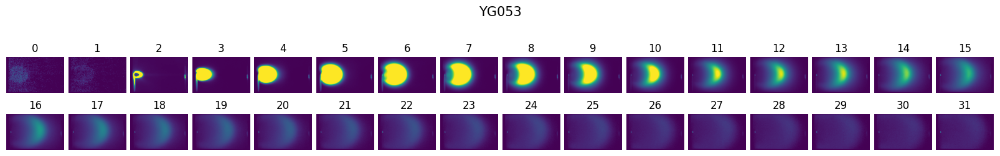

100%|██████████| 219/219 [00:34<00:00,  6.28it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


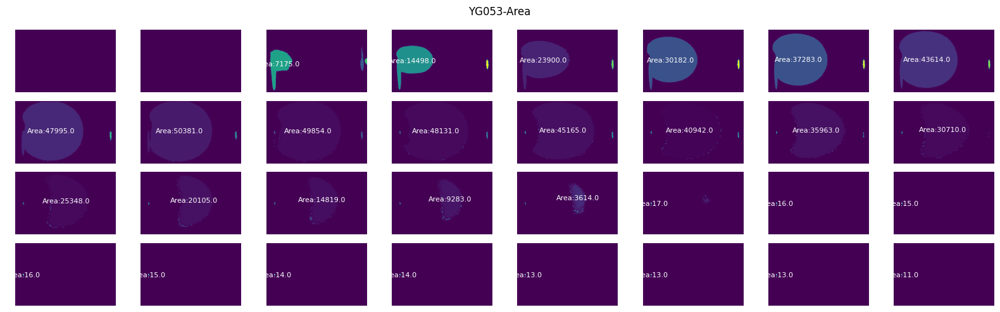

100%|██████████| 219/219 [00:23<00:00,  9.23it/s]


(32, 250, 400) (32, 2) (32,) (32,)


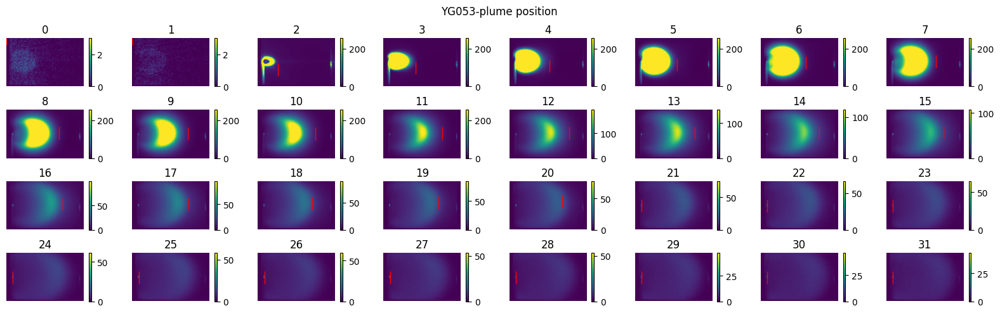

In [33]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG053 = analyze_function(P, V, plumes_YG053, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG053, 'coords_standard':coords_YG045})
df_YG053['Growth'] = 'YG053'

In [34]:
df_all = pd.concat([df_YG045, df_YG046, df_YG047, df_YG048, df_YG049, df_YG050, df_YG051, df_YG053], axis=0)
df_all

Distance     Velocity     Area Growth
plume_index time_index                                       
0           0                -30          0.0      0.0  YG045
            1                -30          0.0      0.0  YG045
            2                 49  158000000.0   4847.0  YG045
            3                103  108000000.0   9351.0  YG045
            4                143   80000000.0  17138.0  YG045
...                          ...          ...      ...    ...
218         123              -30          0.0      0.0  YG053
            124              -30          0.0      0.0  YG053
            125              -30          0.0      0.0  YG053
            126              -30          0.0      0.0  YG053
            127              -30          0.0      0.0  YG053

[207360 rows x 4 columns]

### plot

In [35]:
conditions = ['YG045', 'YG046', 'YG047', 'YG048', 'YG049', 'YG050', 'YG051', 'YG053'] 
df_plot = df_all[df_all['Growth'].isin(conditions)]

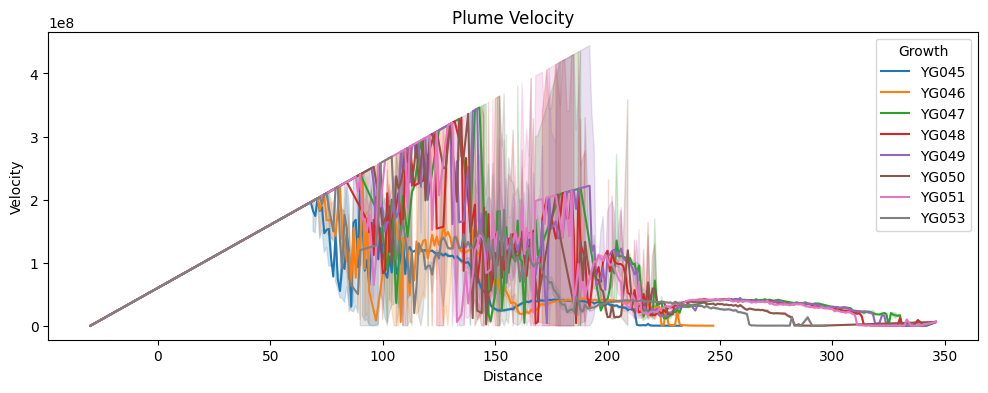

In [36]:
fig, ax = plt.subplots(figsize=(12, 4))
lineplot = sns.lineplot(x="Distance", y="Velocity", hue="Growth", data=df_plot)
plt.title('Plume Velocity')
plt.show()

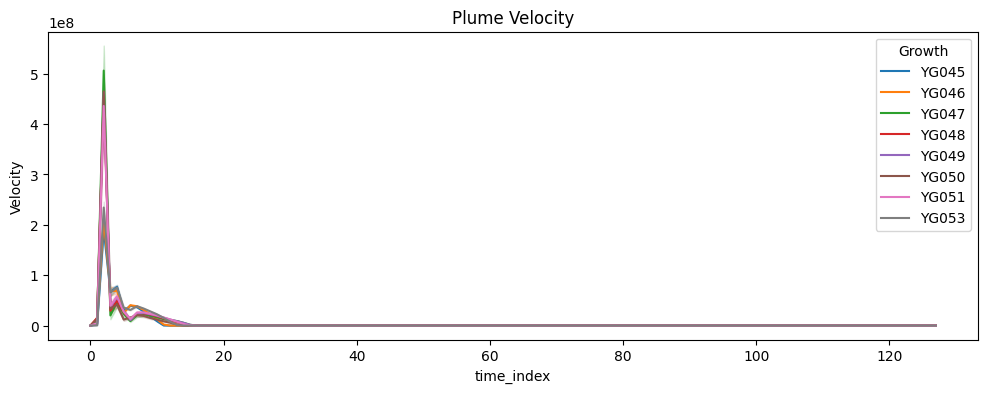

In [37]:
fig, ax = plt.subplots(figsize=(12, 4))
lineplot = sns.lineplot(x="time_index", y="Velocity", hue="Growth", data=df_plot)
plt.title('Plume Velocity')
plt.show()

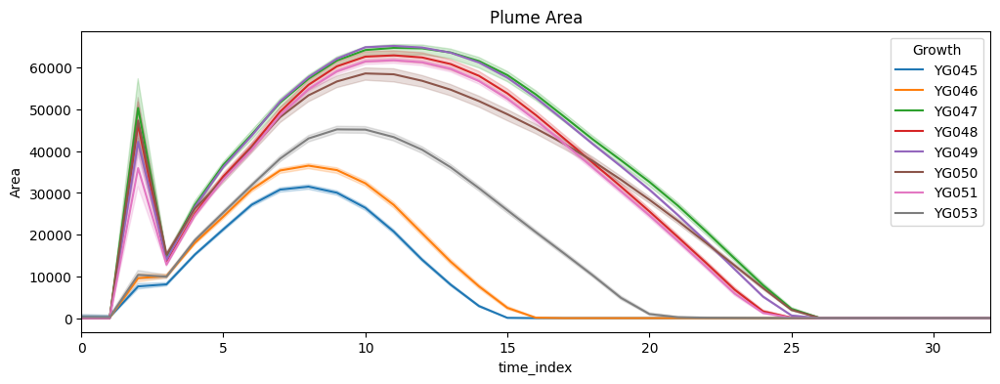

In [38]:
fig, ax = plt.subplots(figsize=(12, 4))
lineplot = sns.lineplot(x="time_index", y="Area", hue="Growth", data=df_plot)
plt.title('Plume Area')
plt.xlim(0, 32)
plt.show()

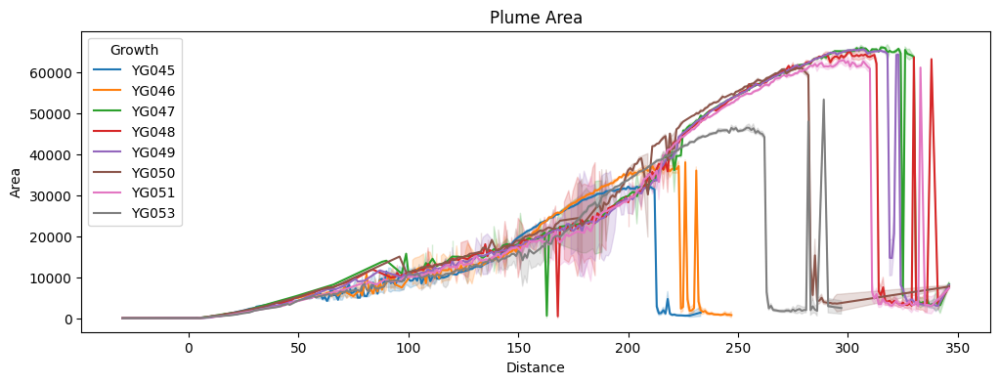

In [39]:
fig, ax = plt.subplots(figsize=(12, 4))
lineplot = sns.lineplot(x="Distance", y="Area", hue="Growth", data=df_plot)
plt.title('Plume Area')
plt.show()